In [1]:
%load_ext autoreload
%autoreload 2

import os, sys
import numpy as np
import sklearn
import itertools
import tensorflow as tf
from sklearn.cluster import KMeans, AgglomerativeClustering, SpectralClustering
from matplotlib import pyplot as plt
from matplotlib.colors import LogNorm

# reproduction module
sys.path.insert(1, os.path.join(sys.path[0], ".."))
from reproduction.pipeline.load import load_data
from reproduction import analysis
from reproduction.pipeline import into_record

# Other necessary packages
from osgeo import gdal
from matplotlib import patches as mpl_patches
from matplotlib.colors import Colormap

In [8]:
def _plotting(swath, patches,patches_labels, SHAPE, colors, ncluster=0):
    line_width = 4
    fig, a = plt.subplots(figsize=(80,80))
    plt.imshow(swath[:,:,0], cmap="bone")
    rects = []   
    for i in range(patches.shape[0]):
        for j in range(patches.shape[1]):
            a.add_patch(mpl_patches.Rectangle(
                (j * SHAPE[0] + line_width , i * SHAPE[1] + line_width ),
                width=SHAPE[0] - line_width * 2,
                height=SHAPE[1] - line_width * 2,
                linewidth=10,
                edgecolor=colors[patches_labels[i,j]],
                facecolor="none"
            ))
            centerx = 64*(2*j+1) #+1
            centery = 64*(2*i+1) #+1
            # add label as text
            plt.text(centerx, centery, str(patches_labels[i,j]), 
                 fontsize=100,weight='bold', 
                 color=colors[patches_labels[i,j]])
    plt.title(" ## %d cluster ## " %ncluster, fontsize=100)
    plt.show()

In [9]:
def _anl_agl(encoder, patches, clusters=0):
    # clustering
    _encs = encoder.predict(patches.reshape((-1, 128, 128, 7)))
    method = AgglomerativeClustering(n_clusters=clusters)
    features = _encs.mean(axis=(1,2))
    patches_labels = method.fit_predict(features).reshape(patches.shape[:2])
    return patches_labels

In [10]:
def _anl_spc(encoder, pathces, clusters=0):
    encs   = encoder.predict(pathces.reshape((-1,128,128,7)))
    method = SpectralClustering(n_clusters=clusters, affinity="nearest_neighbors")
    input_array  =  encs.mean(axis=(1,2))
    patches_labels = method.fit_predict(input_array).reshape(patches.shape[:2])
    return patches_labels

In [11]:
swath_tif = gdal.Open('/project/foster/clouds/data/2015_05/reference_tif/2015-05-03_MOD09GA_background_removal_zero_inputated_image_with_cf_10perc_grid_size10.tif')
print(swath_tif.RasterYSize, swath_tif.RasterYSize)

1345 1345


In [12]:
swath = swath_tif.ReadAsArray()#swath_tif.ReadAsArray(xoff=9400, yoff=4600, xsize=8196, ysize=8196)#(xoff=2600, yoff=3000, xsize=2048, ysize=3072)
swath = np.rollaxis(swath, 0, 3)

In [13]:
swath_mean = swath.mean(axis=(0,1))
swath_std = swath.std(axis=(0,1))
patches = []

stride = 128
patch_size = 128

patches = []
for i in range(0, swath.shape[0], stride):
    row = []
    for j in range(0, swath.shape[1], stride):
        if i + patch_size <= swath.shape[0] and j + patch_size <= swath.shape[1]:
            p = swath[i:i + patch_size, j:j + patch_size].astype(float)
            p -= swath_mean
            p /= swath_std
            
            row.append(p)
    if row:
        patches.append(row)
            
patches = np.stack(patches)

In [20]:
SHAPE = 128, 128, 7

In [14]:
# Color scheme by Ricardo
colors = ["#833f2c",
"#016dec",
"#5cb925",
"#e125a2",
"#2f8900",
"#ff95f9",
"#009650",
"#bb0075",
"#8bd890",
"#d30063",
"#00c7b1",
"#e63e2c",
"#029ebe",
"#f0ae00",
"#b98fff",
"#e1c54c",
"#6e3c92",
"#7ad8b4",
"#ff5655",
"#375c16",
"#ff5677",
"#75481c",
"#ffa2d2",
"#9b280d",
"#ffa47a",
"#952f23",
"#ff804b"]

# Load m15b original version

In [15]:
# outputdata dir
OUTPUTDIR="/project/foster/clouds/output"
ENCODER_DEF = OUTPUTDIR+"/mod09cnn15b/encoder.json"
ENCODER_WEIGHTS = OUTPUTDIR+"/mod09cnn15b/encoder-585000.h5"
ENCODINGS = OUTPUTDIR+"/mod09cnn15b/encodings/m15b-enc"

In [18]:
with open(ENCODER_DEF,"r") as f:
    encoder = tf.keras.models.model_from_json(f.read())
encoder.load_weights(ENCODER_WEIGHTS)

# Agglomerative 

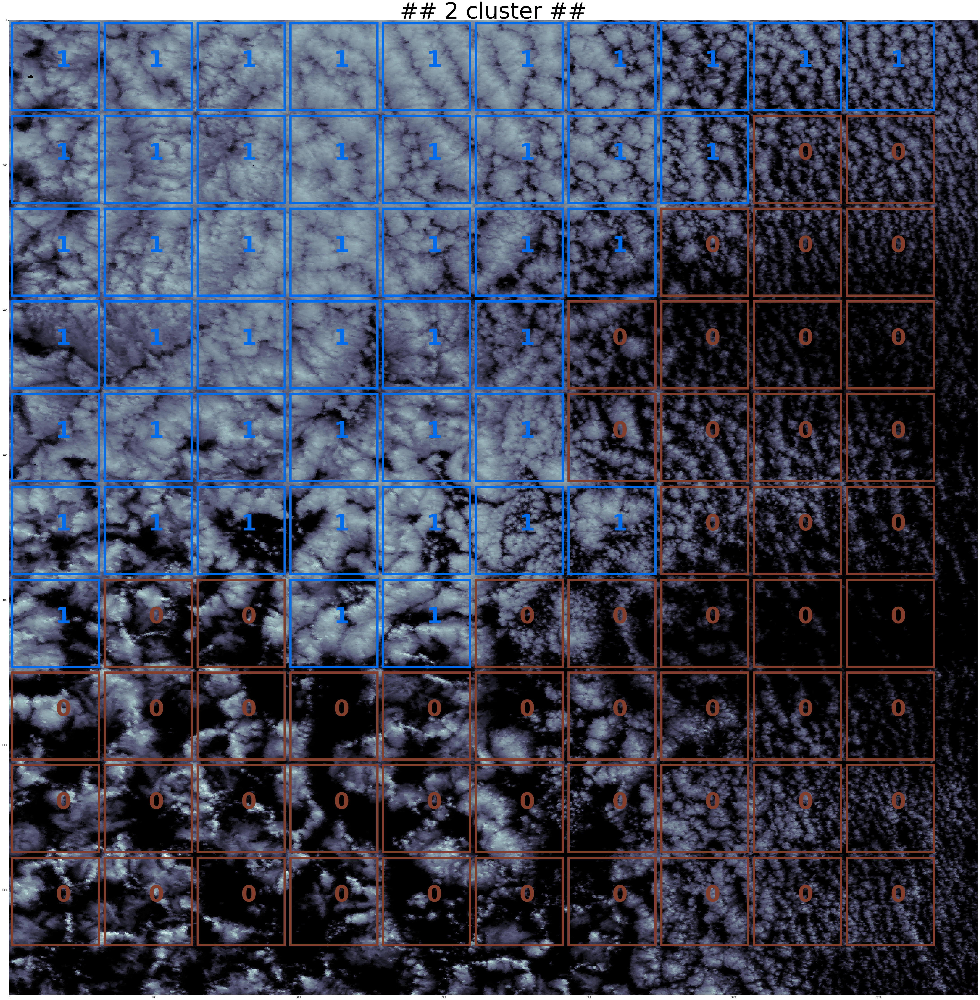

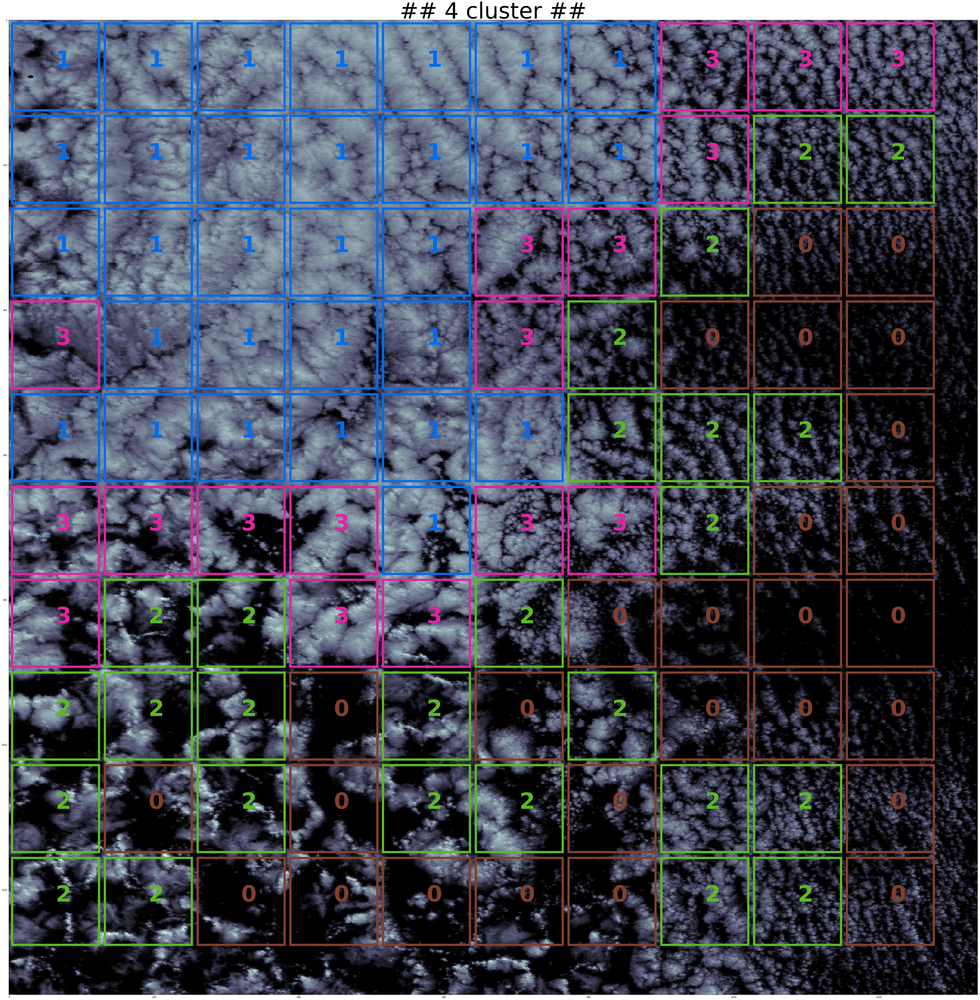

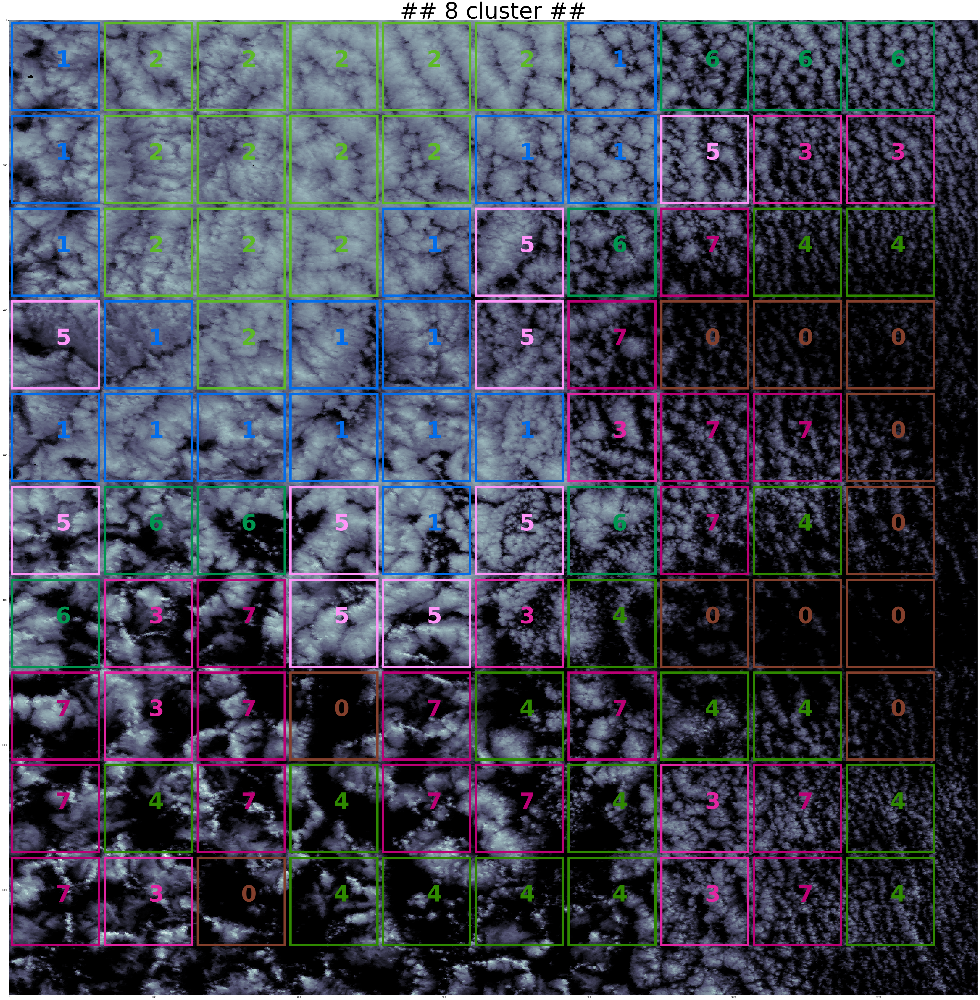

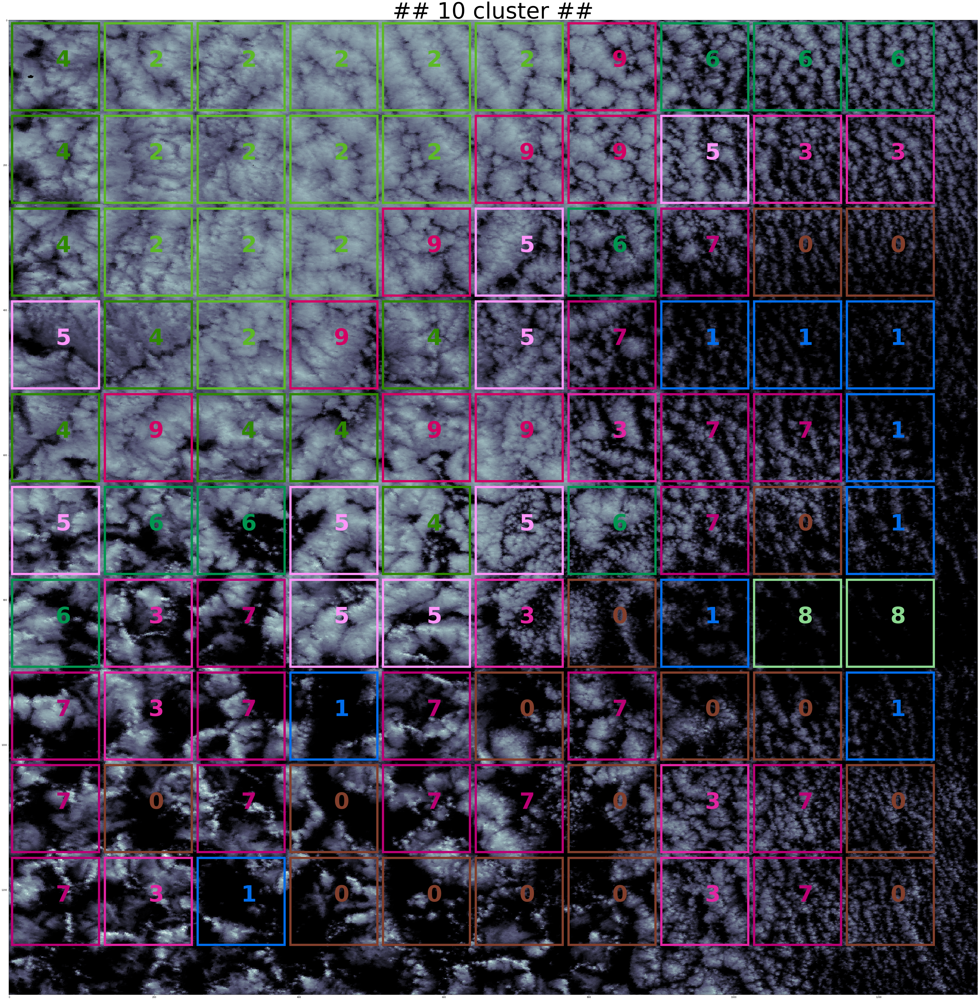

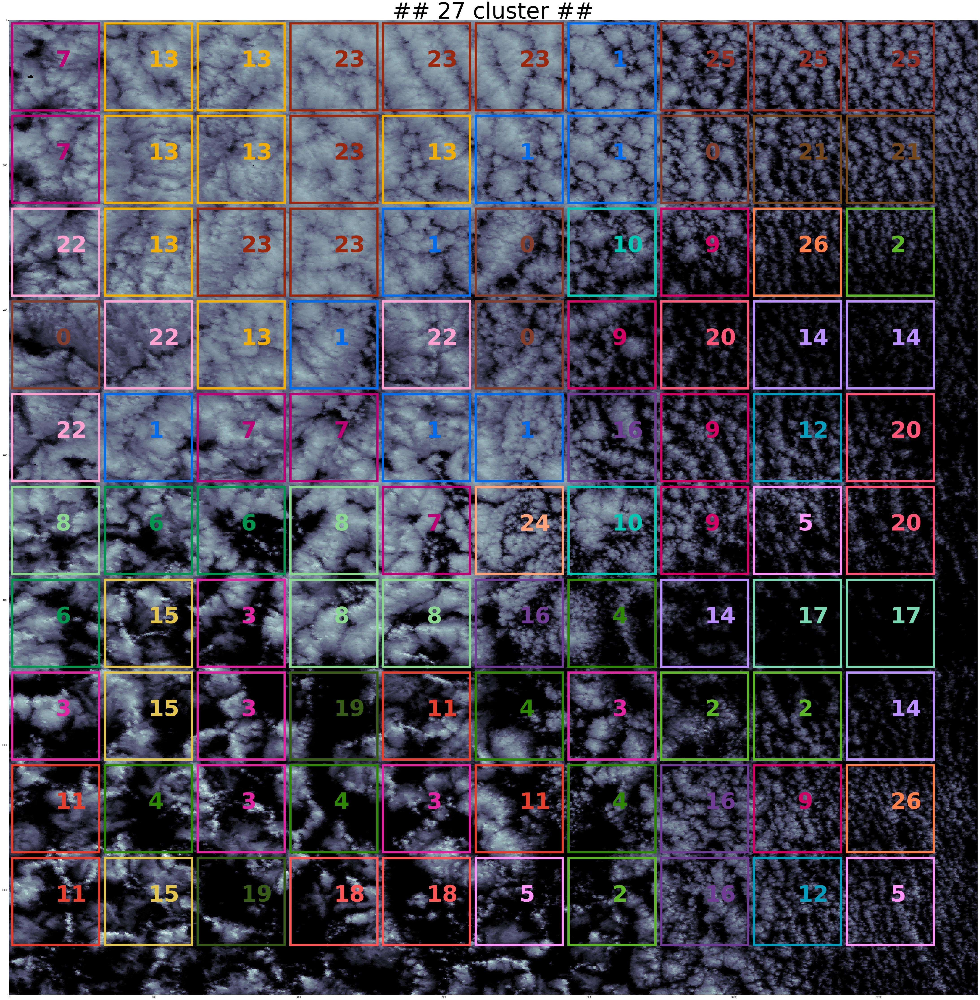

In [21]:
for icluster in [2,4,8,10,27]:
    _patches_labels = _anl_agl(encoder, patches, clusters=icluster)
    _plotting(swath, patches,_patches_labels, SHAPE, colors, ncluster=icluster)

# Spectral Clustering

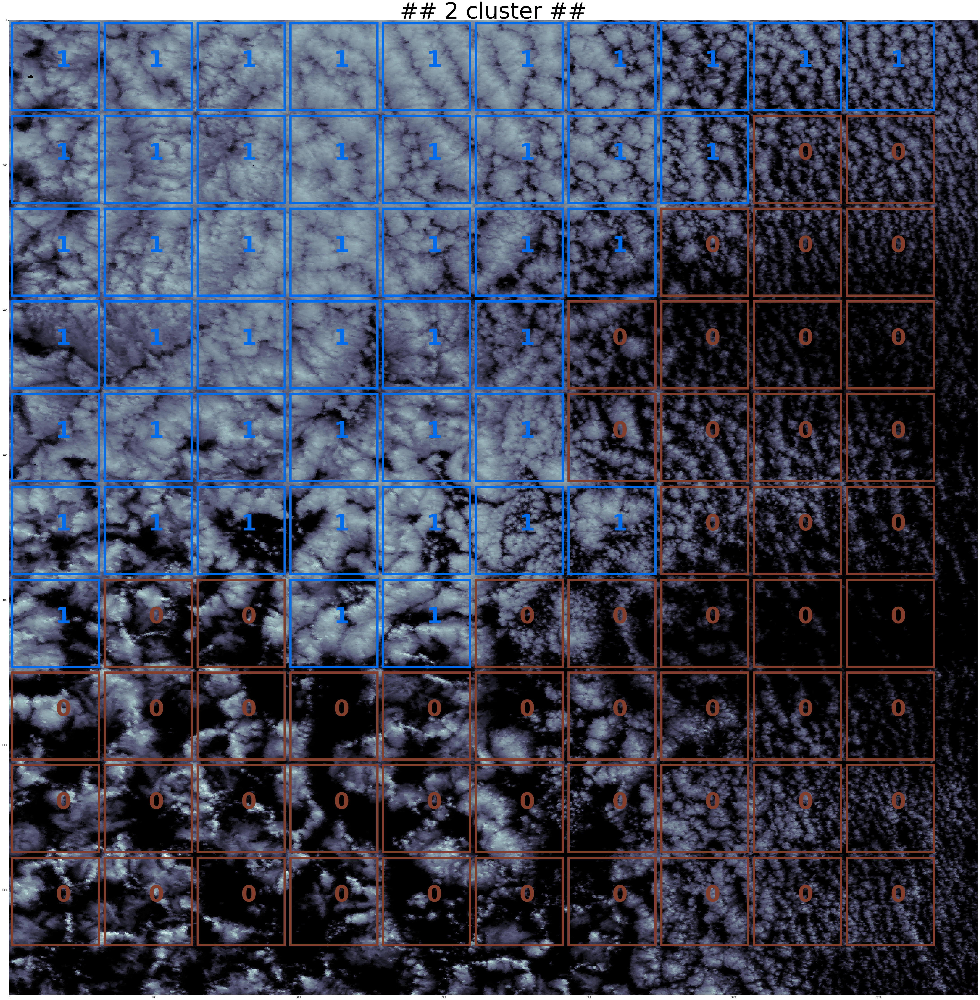

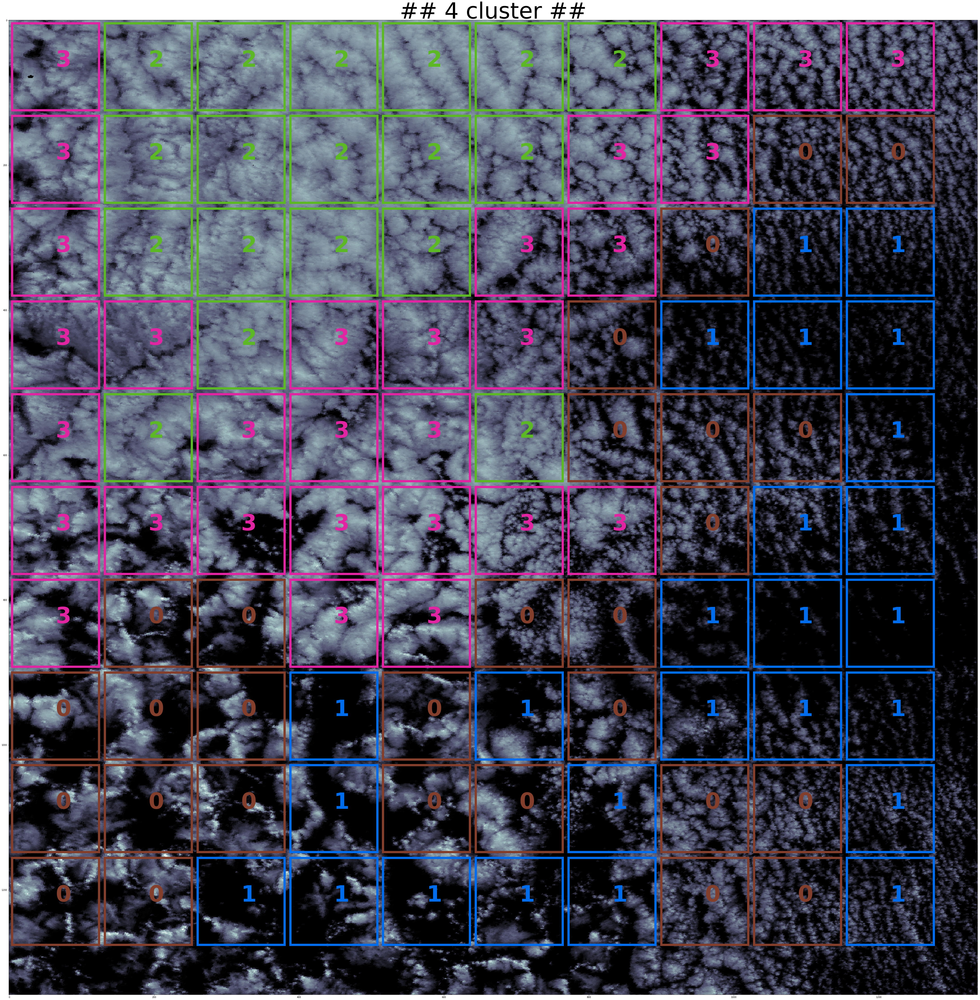

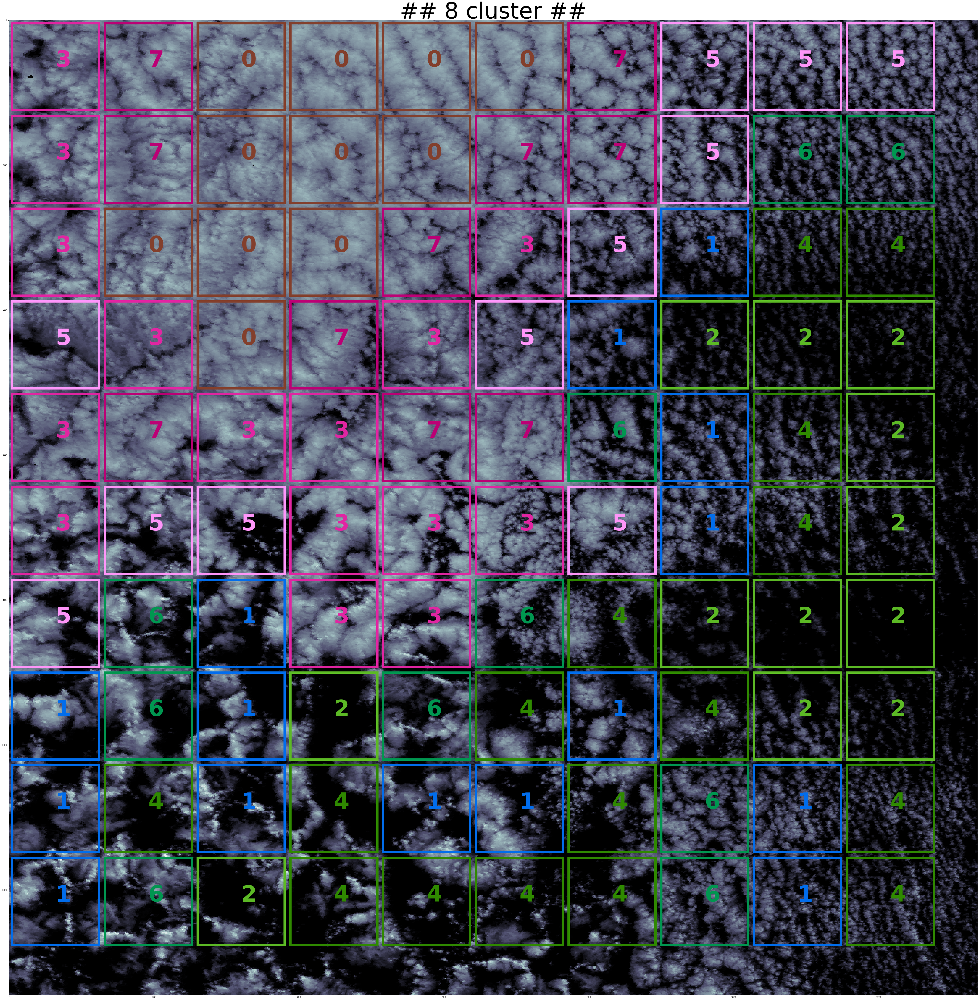

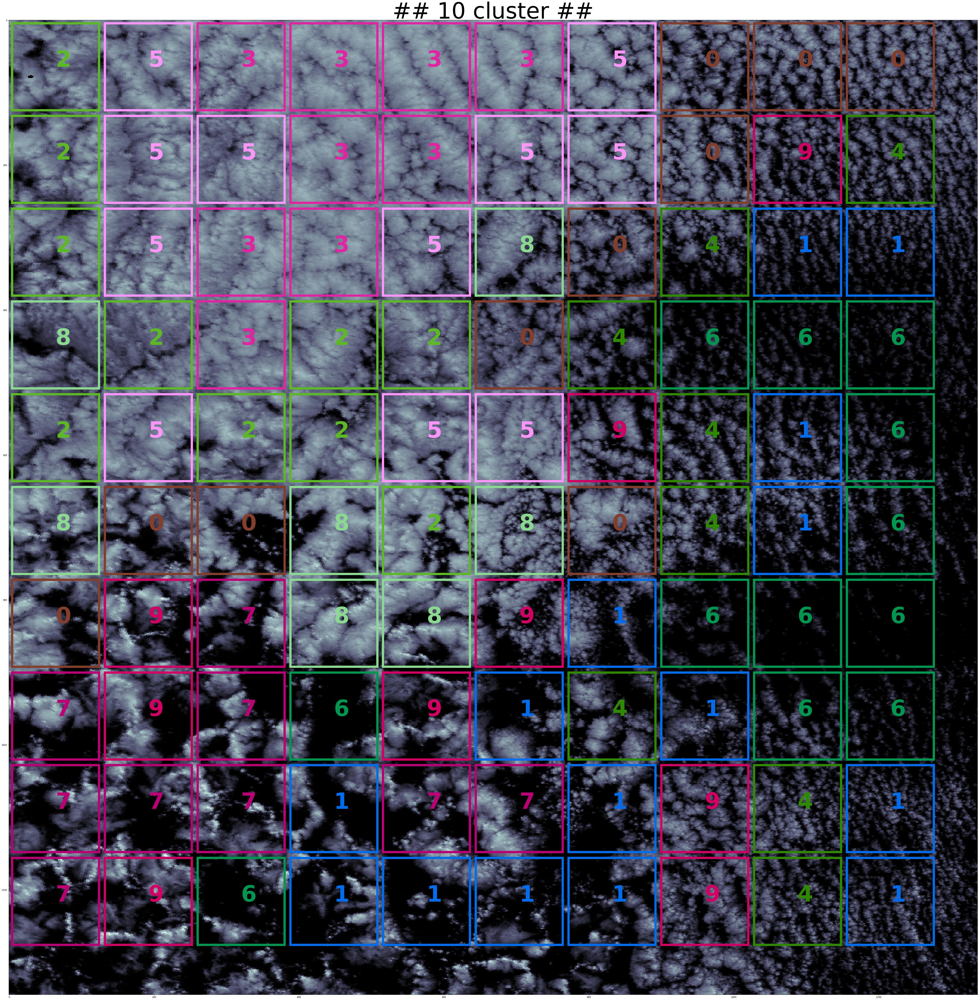

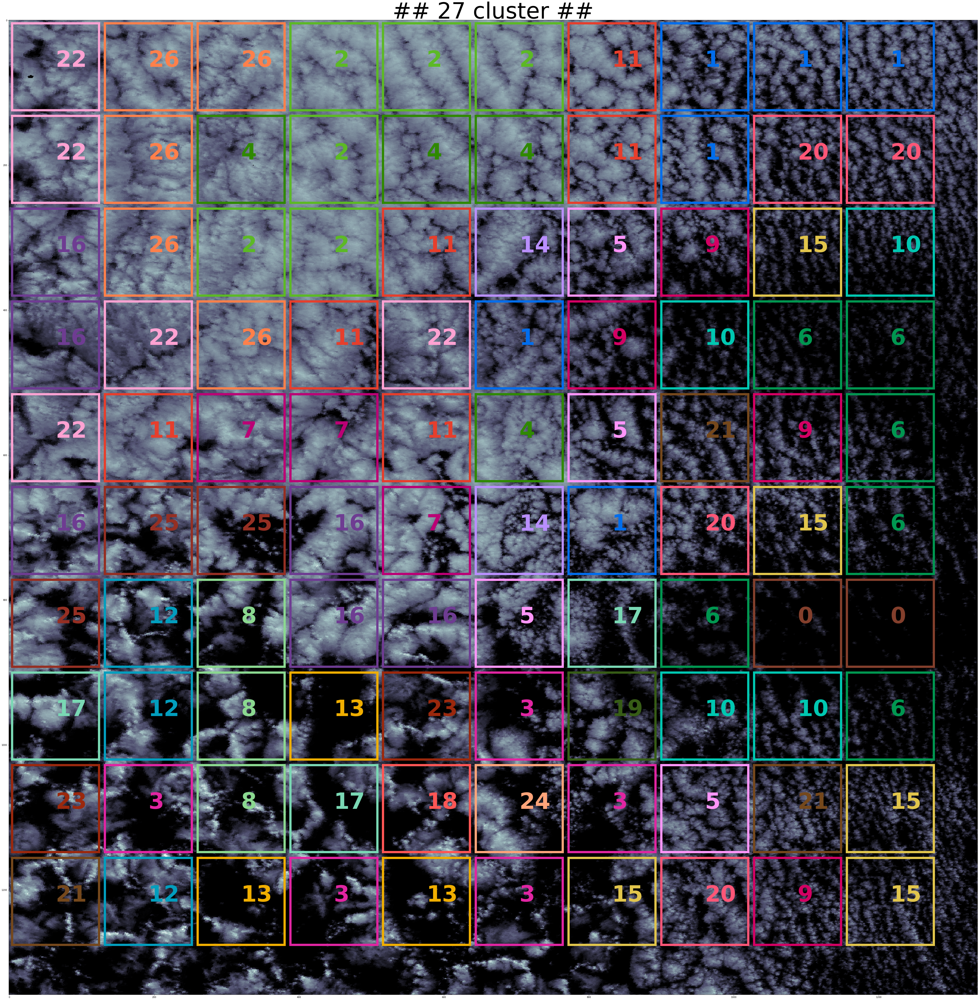

In [22]:
for icluster in [2,4,8,10,27]:
    _patches_labels = _anl_spc(encoder, patches, clusters=icluster)
    _plotting(swath, patches,_patches_labels, SHAPE, colors, ncluster=icluster)